# Hungary road network centrality analysis

In [ ]:
!!pip install osmnx

In [ ]:
!pip install folium

In [2]:
import osmnx as ox
from sklearn.cluster import AgglomerativeClustering
import networkx as nx
import numpy as np
import matplotlib.pyplot as plt
import folium
import pandas as pd
import seaborn as sns
from IPython.display import IFrame

### Making the data

Getting primary road segments from OpenStreetMap!

In [5]:
custom_filter = '["highway"~"motorway|primary|trunk"]'
ox.config(use_cache=True, log_console=True)
G = ox.graph_from_place('Hungary', network_type=None, custom_filter=custom_filter, simplify = True)

2022-02-24 21:44:25 Configured OSMnx 1.1.2
2022-02-24 21:44:25 HTTP response caching is on
2022-02-24 21:44:25 Retrieved response from cache file "cache/9eb20eec3babd598d3d131d8e3f9b85cadff1d5a.json"
2022-02-24 21:44:25 Created GeoDataFrame with 1 rows from 1 queries
2022-02-24 21:44:25 Constructed place geometry polygon(s) to query API
2022-02-24 21:44:25 Projected GeoDataFrame to +proj=utm +zone=34 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs
2022-02-24 21:44:26 Projected GeoDataFrame to epsg:4326
2022-02-24 21:44:26 Projected GeoDataFrame to +proj=utm +zone=34 +ellps=WGS84 +datum=WGS84 +units=m +no_defs +type=crs
2022-02-24 21:44:26 Projected GeoDataFrame to epsg:4326
2022-02-24 21:44:26 Requesting data within polygon from API in 67 request(s)
2022-02-24 21:44:26 Retrieved response from cache file "cache/641bb460045e3c4d34a6062bc20bc0c469b1d712.json"
2022-02-24 21:44:26 Retrieved response from cache file "cache/6a389a7857a65d515164bb68a6abd976e8338afd.json"
2022-02-24 21:44

2022-02-24 21:44:29 Created graph with 229881 nodes and 358891 edges
2022-02-24 21:44:30 Added length attributes to graph edges
2022-02-24 21:44:30 Identifying all nodes that lie outside the polygon...
2022-02-24 21:44:35 Created nodes GeoDataFrame from graph
2022-02-24 21:44:39 Created r-tree spatial index for 229881 geometries
2022-02-24 21:44:46 Identified 191349 geometries inside polygon
2022-02-24 21:44:48 Removed 38532 nodes outside polygon
2022-02-24 21:44:48 Truncated graph by polygon
2022-02-24 21:44:48 Begin topologically simplifying the graph...
2022-02-24 21:44:52 Identified 8934 edge endpoints
2022-02-24 21:44:59 Simplified graph: 191349 to 8934 nodes, 291973 to 14353 edges
2022-02-24 21:44:59 Identifying all nodes that lie outside the polygon...
2022-02-24 21:44:59 Created nodes GeoDataFrame from graph
2022-02-24 21:44:59 Created r-tree spatial index for 8934 geometries
2022-02-24 21:45:06 Identified 8685 geometries inside polygon
2022-02-24 21:45:07 Removed 249 nodes out

The query results.\
A problem in new version of matplotlib does not let us to plot please run this when running code in colab

In [ ]:
!python -m pip uninstall matplotlib
!!pip install matplotlib==3.1.3

Let's focus on the downtown, otherwise, the area is still to big for this hands-on session.

In [35]:
nodes, edges = ox.graph_to_gdfs(G)

2022-02-24 20:06:22 Created nodes GeoDataFrame from graph
2022-02-24 20:06:38 Created edges GeoDataFrame from graph


Count streets (undirected edges) incident on each node.

In [36]:
stats = ox.basic_stats(G)
stats_df=pd.DataFrame(index=stats.keys(), data=stats.values())
stats_df

2022-02-24 20:06:46 Created edges GeoDataFrame from graph
2022-02-24 20:06:59 Converted MultiDiGraph to undirected MultiGraph


,0
n,173593
m,271661
k_avg,3.129861
edge_length_total,17579173.854
edge_length_avg,64.709965
streets_per_node_avg,2.036453
streets_per_node_counts,"{0: 0, 1: 760, 2: 166083, 3: 6447, 4: 279, 5: ..."
streets_per_node_proportions,"{0: 0.0, 1: 0.004378056718876913, 2: 0.9567378..."
intersection_count,172833
street_length_total,10821571.996


In [37]:
Count_street=stats_df.loc['streets_per_node_counts'].values[0]
Count_street_df=pd.DataFrame(index=Count_street.keys(), data=Count_street.values())
Count_street_df.reset_index(inplace=True)
Count_street_df.rename(columns={0:'count','index':'street_count'}, inplace=True)
Count_street_df

,street_count,count
0,0,0
1,1,760
2,2,166083
3,3,6447
4,4,279
5,5,13
6,6,11


<AxesSubplot:xlabel='street_count', ylabel='count'>

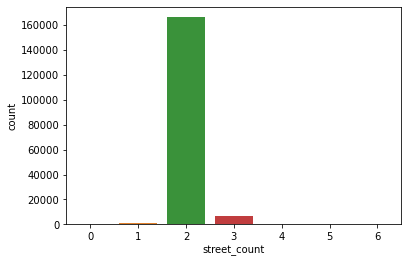

In [38]:
sns.barplot(x="street_count", y="count", data=Count_street_df)

In [6]:
ox.io.save_graphml(G, filepath='Hungray_freeways_2.graphml', gephi=False, encoding='utf-8')

2022-02-24 21:45:08 Saved graph as GraphML file at "Hungray_freeways_2.graphml"


### IO from data in link(Run this with file in the page

In [40]:
G=ox.io.load_graphml(filepath='Hungray_freeways_3.graphml')

2022-02-24 20:07:27 Converting node, edge, and graph-level attribute data types
2022-02-24 20:07:28 Loaded graph with 173593 nodes and 271661 edges from "Hungray_freeways_3.graphml"


### Run this for plots

2022-02-24 20:07:28 Begin plotting the graph...
2022-02-24 20:07:44 Created edges GeoDataFrame from graph
2022-02-24 20:07:59 Created nodes GeoDataFrame from graph


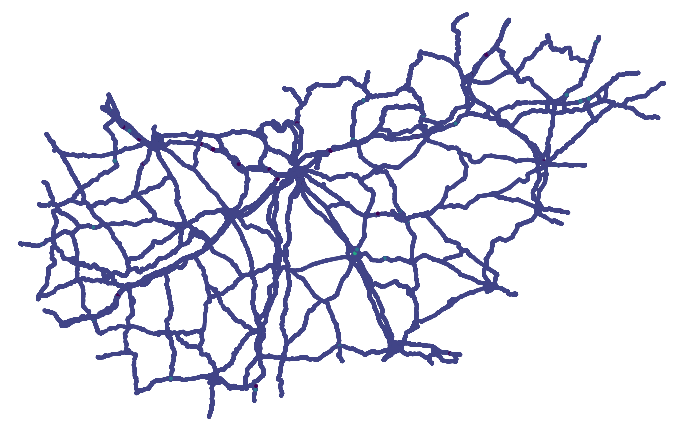

2022-02-24 20:08:09 Finished plotting the graph


(<Figure size 864x576 with 1 Axes>, <AxesSubplot:>)

In [41]:
fig, ax = plt.subplots(figsize=(12,8))
ox.plot_graph(G,node_color=nodes.street_count,ax=ax)

In [7]:
ox.plot_graph_folium(G, weight=2, color="#8b0000")

2022-02-24 21:48:14 Created edges GeoDataFrame from graph


run this to save

In [ ]:
m1=ox.plot_graph_folium(G, popup_attribute="name", weight=2, color="#8b0000")
# save as html file then display map as an iframe
filepath = "graph_3.html"
m1.save(filepath)

In [ ]:
nodes, edges = ox.graph_to_gdfs(G)

In [ ]:
nodes

In [ ]:
edges.head(2).T

In [ ]:
edges["maxspeed"].value_counts()

###If you don't want to eliminate nodes with degee 2 and their paths donot run this cells.

creat new nodes gdf which has street count of non2

In [ ]:
nodes_to_remove=(nodes[nodes['street_count']==2]).index.values
new_nodes = nodes[~nodes.index.isin(nodes_to_remove)]

creat new edges gdf which has street count of non2

In [ ]:
New_edges=edges[(~edges.index.get_level_values(0).isin(nodes_to_remove))]

In [ ]:
New_G=ox.utils_graph.graph_from_gdfs(new_nodes,New_edges)

<Figure size 1080x1080 with 0 Axes>

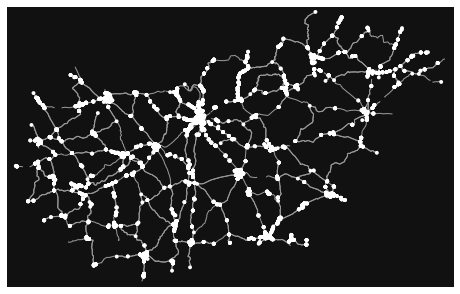

In [ ]:
plt.figure(figsize=(15,15))
ox.plot_graph(New_G)
plt.show()